In [32]:
# run this from a terminal, to install the packet:
#pip install geopy
import geopy
from geopy.geocoders import Nominatim
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import csv
from os.path import join
#this will allow the plot to be inline in the browser
%matplotlib inline

In [33]:
lines = np.loadtxt("migration.csv",dtype='str',delimiter=',')
#links = np.loadtxt("THE_LINKS.txt",dtype=[('f0', '|S5'), ('f1', '|S5'),('f2', float), ('f3', int)],usecols=(0,1,2,3))


In [34]:
len(lines)
destinations=lines[0];

In [35]:
g = nx.DiGraph()

for i in range(1,len(lines)-1): 
    count=0;
    data=lines[i];
    node=data[0];
    for col in data[1:]:
        count=count+1;
        d=destinations[count];
        wij=int(col)
        g.add_edge(node,d,weight=wij)
        #print node,' ',d,' ',col
        #print col

In [6]:
from geopy.exc import GeocoderTimedOut
from geopy.geocoders import Nominatim
geolocator = Nominatim()
location = geolocator.geocode("USA")
print location.latitude,' ',location.longitude

39.7837304   -100.4458825


In [7]:
from geopy.exc import GeocoderTimedOut
from geopy.geocoders import Nominatim
geolocator = Nominatim()
location = geolocator.geocode("USA")
print location.latitude,' ',location.longitude


### Here we use it to create the dictionary with coordinates
pos = {}
for n in g.nodes():
    print n
    location = geolocator.geocode(n,timeout=30)
    pos[n] = (location.longitude,location.latitude)
    #print location.latitude," ",location.longitude


39.7837304   -100.4458825
Canada
East Timor
Sao Tome and Principe
Turkmenistan
Lithuania
Cambodia
Ethiopia
Aruba
Swaziland
Palestine
Argentina
Bolivia
Cameroon
Burkina Faso
Ghana
Saudi Arabia
Japan
Channel Islands
Cape Verde
Slovenia
Guatemala
Bosnia and Herzegovina
Kuwait
Jordan
Spain
Liberia
Maldives
Pakistan
Oman
Tanzania
Martinique
French Guiana
New Zealand
Yemen
Jamaica
Albania
Samoa
United Arab Emirates
Guam
India
Azerbaijan
Lesotho
Saint Vincent and the Grenadines
Kenya
South Korea
Macao
Turkey
Afghanistan
Bangladesh
Mauritania
Solomon Islands
Saint Lucia
Kyrgyzstan
Mongolia
France
Rwanda
Namibia
Somalia
Peru
Laos
Republic of Congo
Norway
Malawi
Benin
Libya
Cuba
Montenegro
Togo
Virgin Islands
China
Armenia
Dominican Republic
French Polynesia
Ukraine
Bahrain
Tonga
Finland
Western Sahara
Indonesia
Central African Republic
Mauritius
Tajikistan
Sweden
Belarus
Mali
Russia
Bulgaria
United States
Romania
Angola
Portugal
Trinidad and Tobago
Cyprus
Qatar
Malaysia
Austria
Vietnam
Mozambiq

# Check minimum and maximun weight of of edges

In [8]:
edgeweights = []
for (u,v,d) in g.edges(data='weight'):
    edgeweights.append(d)

print "min= ",min(edgeweights),"and max= ",max(edgeweights)


min=  0 and max=  1957397


# Check minimum and maximun weighted in-degree and  of of nodes

In [9]:
min_w_deg=min(dict(g.in_degree(weight='weight')).values())

max_w_deg=max(dict(g.in_degree(weight='weight')).values())
print "min= ",min_w_deg,"and max= ",max_w_deg
in_degrees=g.in_degree(weight='weight')
    # sort nodes by degree
from operator import itemgetter
in_nodes=sorted(g.in_degree(weight='weight'),key=itemgetter(1))

min=  0 and max=  6804989


In [10]:
in_nodes

[('East Timor', 0),
 ('Samoa', 0),
 ('Micronesia', 0),
 ('Zimbabwe', 0),
 ('Cambodia', 15),
 ('Sri Lanka', 83),
 ('Lesotho', 88),
 ('Peru', 122),
 ('Tonga', 239),
 ('Comoros', 245),
 ('Virgin Islands', 261),
 ('Tajikistan', 272),
 ('Cuba', 282),
 ('Grenada', 500),
 ('Puerto Rico', 578),
 ('Georgia', 651),
 ('Vanuatu', 669),
 ('Malawi', 689),
 ('Sao Tome and Principe', 837),
 ('Saint Vincent and the Grenadines', 851),
 ('Solomon Islands', 888),
 ('Somalia', 992),
 ('French Polynesia', 1000),
 ('Martinique', 1211),
 ('Guam', 1292),
 ('Nicaragua', 1367),
 ('Trinidad and Tobago', 1417),
 ('Saint Lucia', 1933),
 ('Morocco', 2068),
 ('Mayotte', 2114),
 ('Tunisia', 2179),
 ('Kyrgyzstan', 2274),
 ('Armenia', 2337),
 ('Guinea-Bissau', 2619),
 ('Laos', 3036),
 ('Guyana', 3044),
 ('Namibia', 3101),
 ('Turkmenistan', 3289),
 ('Fiji', 3304),
 ('Zambia', 3484),
 ('Ethiopia', 3517),
 ('Haiti', 3578),
 ('Djibouti', 3625),
 ('Guinea', 3794),
 ('Reunion', 3805),
 ('Honduras', 4041),
 ('Guadeloupe', 4126

In [11]:
count=0;
z=[];
y=[];
nn=[];
for n in in_nodes:
    count=count+2;
    z.append(count);
    net=dict(g.in_degree(n,'weight')).values()[0]-dict(g.out_degree(n,'weight')).values()[0]
    y.append(net)
    nn.append(n[0]) ;        
    print n[0],' ',dict(g.in_degree(n,'weight')).values()[0],' ',dict(g.out_degree(n,'weight')).values()[0]," ",net

East Timor   0   49871   -49871
Samoa   0   15735   -15735
Micronesia   0   8992   -8992
Zimbabwe   0   0   0
Cambodia   15   254784   -254769
Sri Lanka   83   249657   -249574
Lesotho   88   20282   -20194
Peru   122   725157   -725035
Tonga   239   8434   -8195
Comoros   245   10253   -10008
Virgin Islands   261   3862   -3601
Tajikistan   272   296352   -296080
Cuba   282   190423   -190141
Grenada   500   5500   -5000
Puerto Rico   578   145661   -145083
Georgia   651   150685   -150034
Vanuatu   669   671   -2
Malawi   689   52484   -51795
Sao Tome and Principe   837   7337   -6500
Saint Vincent and the Grenadines   851   5855   -5004
Solomon Islands   888   877   11
Somalia   992   300941   -299949
French Polynesia   1000   1415   -415
Martinique   1211   3212   -2001
Guam   1292   1288   4
Nicaragua   1367   201330   -199963
Trinidad and Tobago   1417   21221   -19804
Saint Lucia   1933   2940   -1007
Morocco   2068   677053   -674985
Mayotte   2114   2419   -305
Tunisia   2179 

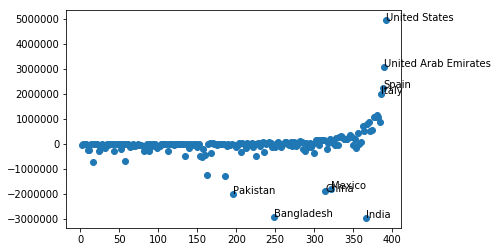

In [12]:
fig, ax = plt.subplots()
ax.scatter(z, y)
for i, txt in enumerate(nn): #writing the names if the growth or decrease is more than 1.5M
    if(abs(y[i])>1500000):
        ax.annotate(txt, (z[i],y[i]))

In [13]:
g.out_degree('United States','weight')

1869951

In [14]:
min_wout_deg=min(dict(g.out_degree(weight='weight')).values())
max_wout_deg=max(dict(g.out_degree(weight='weight')).values())
print "min= ",min_wout_deg,"and max= ",max_wout_deg


min=  0 and max=  3724386


In [15]:
g.number_of_nodes()

196

In [16]:
np.median(dict(g.out_degree(weight='weight')).values())

51930.5

In [17]:
np.median(dict(g.in_degree(weight='weight')).values())

29992.5

In [18]:
for a, b, data in sorted(g.edges(data=True), key=lambda (a, b, data): data['weight']):
    if data['weight'] > 200000:
        print('{a} {b} {w}'.format(a=a, b=b, w=data['weight']))

Indonesia United Arab Emirates 200422
China South Korea 216747
India United Kingdom 250403
China Hong Kong 251540
United States Italy 255654
Morocco Spain 265763
Afghanistan Iran 266595
El Salvador United States 268935
Pakistan Saudi Arabia 285441
Tanzania Burundi 294595
India Qatar 297570
Uzbekistan Russia 299656
Kazakhstan Russia 307495
Indonesia Malaysia 346048
Myanmar Thailand 368832
Philippines United States 373024
Malaysia Singapore 395727
Pakistan United Arab Emirates 494846
Bangladesh Saudi Arabia 523342
China United States 615536
Bangladesh India 630451
Bangladesh United Arab Emirates 646729
India United States 701242
India United Arab Emirates 1149965
Mexico United States 1957397


# Activity: Display colors of nodes by 3 sizes respect to their incoming trips


In [19]:
import matplotlib.colors as colors
plt.figure(3)

degree_in=dict(g.in_degree(weight='weight')).values()

ns=[] #saves node size
nc=[] #saves node color
n_label = {}
#for n in g.nodes_iter():
 #   n_label[n] = n

for node in g.nodes():   
    dn=g.in_degree(node,'weight')
    #print node 
    if(dn>=500000):
        n_label[node] = node
        ns.append(4000)
        nc.append("red")
    if(dn>=100000 and dn<500000):
        ns.append(2000)
        nc.append("green")
        n_label[node] = node
    if(dn<100000):
        ns.append(1000)  
        nc.append("yellow")  
   
        

In [20]:
#pos=nx.spring_layout(g)
plt.figure(figsize=(200,150))
nx.draw_networkx_nodes(g, pos=pos, node_size=ns, 
             node_color = nc)
nx.draw_networkx_labels(g,pos,n_label,font_size=90,font_color='k')
plt.title('All Trips',fontsize=150)
plt.axis('off')
plt.savefig('map0', format='pdf')

# Activity: Show links only in several ranges of weight values

In [21]:
# Create list of edeges by color

eI = [] 
eII = [] 
eIII = [] 
eIV= []  

for u,v in g.edges():
    wij=g.get_edge_data(u,v)['weight']
    if (wij>=500000):   
       eI.append((u,v)) 
    if (wij>=100000 and wij<500000):   
       eII.append((u,v))
    if (wij>=10000 and wij<100000):   
       eIII.append((u,v))
    if (wij<10000):   
       eIV.append((u,v))
          

(-212.39520859049998, 216.2048398905, -52.649654753499995, 75.83588525350001)

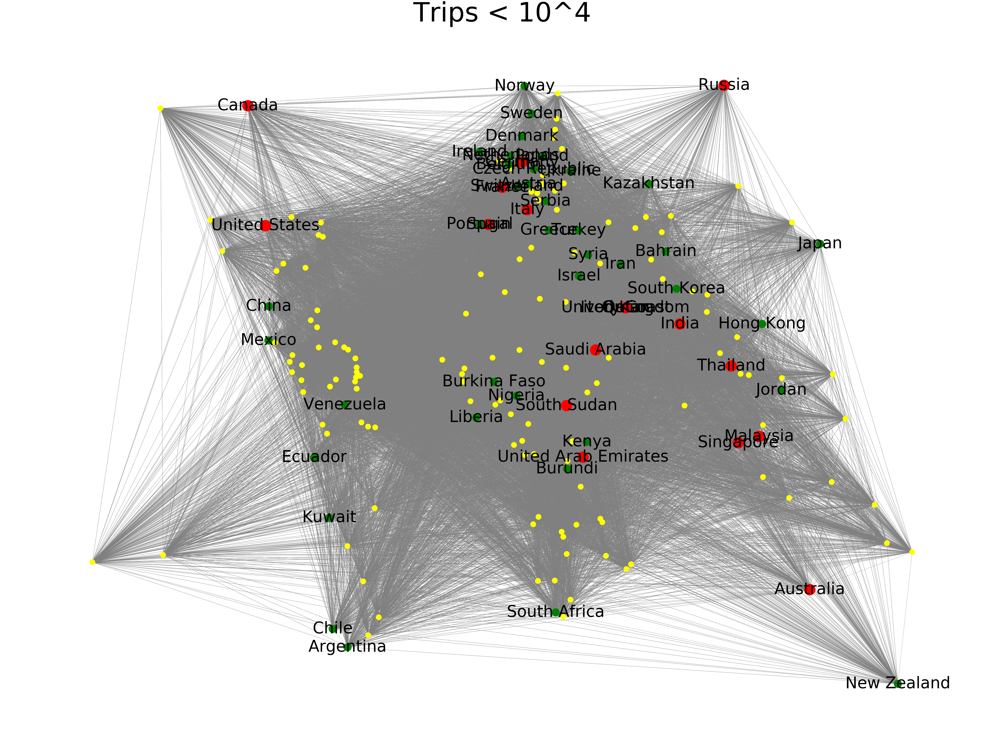

In [22]:
#here we show the edgelist I
plt.figure(5)
plt.figure(figsize=(100,75))
nx.draw_networkx_edges(g,pos,edgelist=eIV,width=1,alpha=0.9,edge_color='gray')
nx.draw_networkx_nodes(g,pos=pos,label=n_label,with_labels=True,node_size=ns,node_color=nc)
nx.draw_networkx_labels(g,pos,n_label,font_size=90,font_color='k')
plt.title('Trips < 10^4',fontsize=150)
plt.axis('off')
               

# Checking that we cover all edges

In [23]:
len(eI)

7

In [24]:
len(eII)

75

In [25]:
len(eIII)

468

In [26]:
len(eIV)

37670

In [27]:
len(g.edges())

38220

In [28]:
len(eI)+len(eII)+len(eIII)+len(eIV)

38220

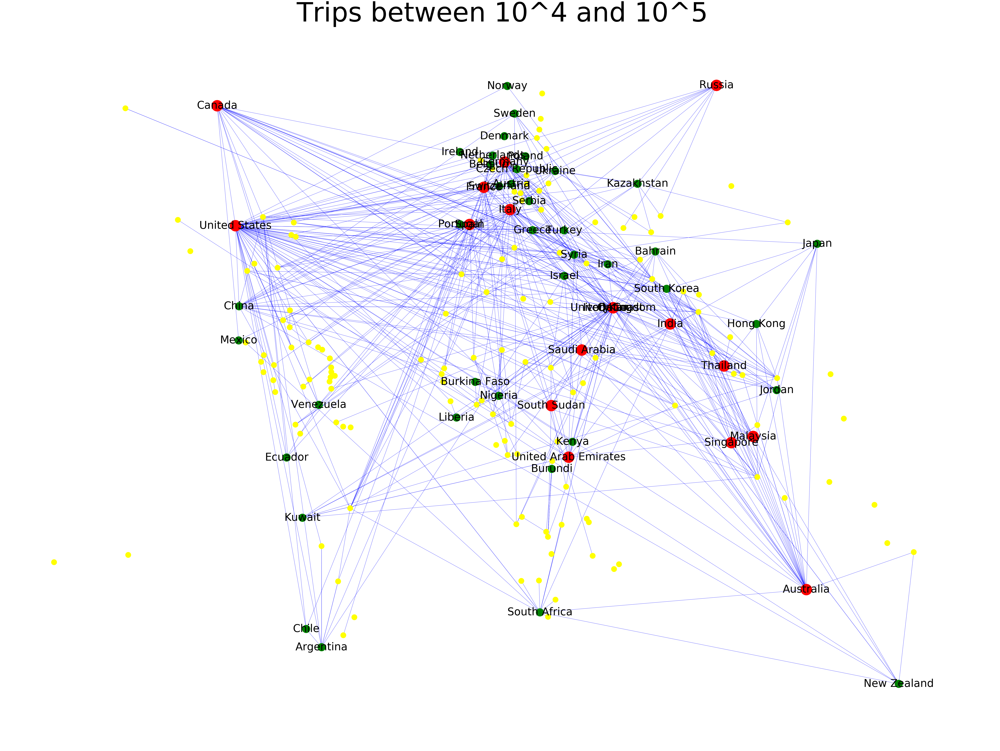

In [29]:
plt.figure(6)
plt.figure(figsize=(100,75))
nx.draw_networkx_edges(g, pos, edgelist = eIII, width = 1 , alpha = 0.9, edge_color='blue')
nx.draw_networkx_nodes(g,pos=pos,node_size=ns,node_color=nc,edge_color='gray')
nx.draw_networkx_labels(g,pos,n_label,font_size=60,font_color='k')
plt.title('Trips between 10^4 and 10^5',fontsize=150)
plt.axis('off')
plt.savefig('map3', format='pdf',dpi=1000)

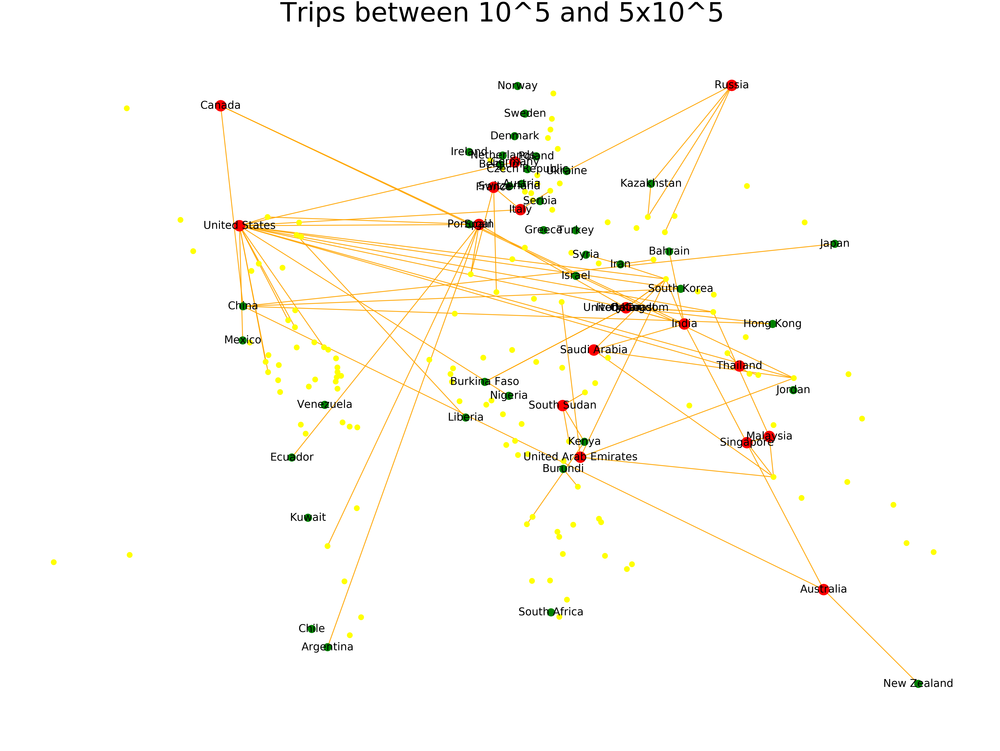

In [30]:
#here we show the edgelist II
plt.figure(7)
plt.figure(figsize=(100,75))
nx.draw_networkx_edges(g, pos, edgelist = eII, width = 5 , alpha = 0.9, edge_color='orange')
nx.draw_networkx_nodes(g,pos=pos,node_size=ns,node_color=nc,edge_color='gray')
nx.draw_networkx_labels(g,pos,n_label,font_size=60,font_color='k')
plt.title('Trips between 10^5 and 5x10^5',fontsize=150)
plt.axis('off')
plt.savefig('map2', format='pdf',dpi=1000)                 

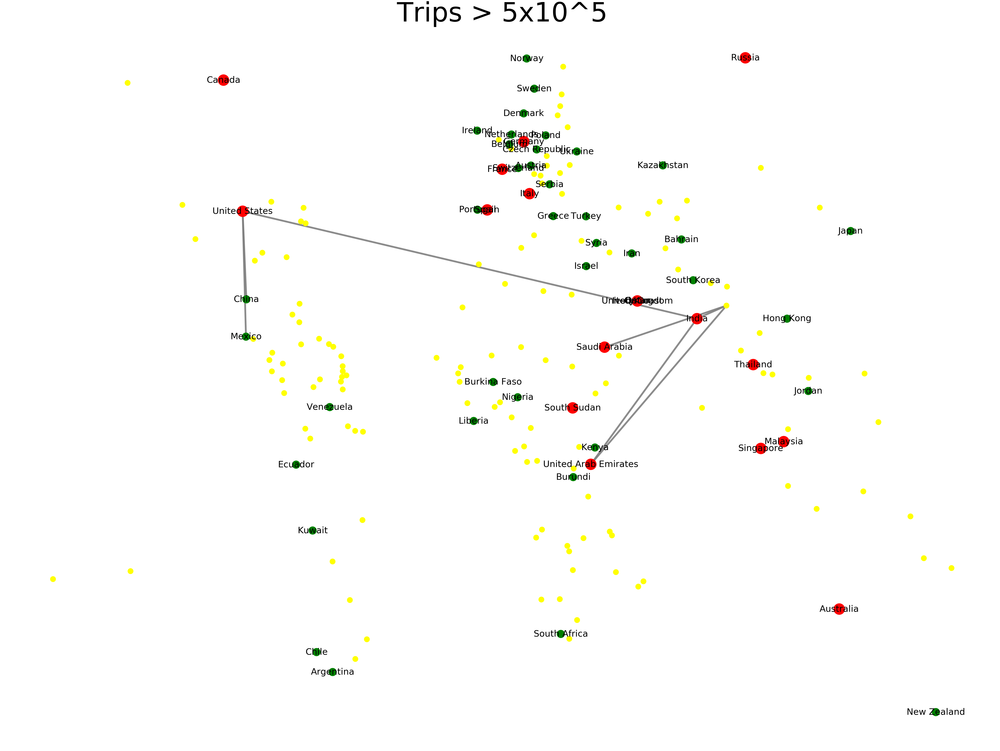

In [31]:
#here we show the edgelist I
plt.figure(8)
plt.figure(figsize=(100,75))
nx.draw_networkx_edges(g, pos, edgelist = eI, width = 10 , alpha = 0.9, edge_color='gray')
nx.draw_networkx_nodes(g,pos=pos,node_size=ns,node_color=nc,edge_color='gray')
nx.draw_networkx_labels(g,pos,n_label,font_size=50,font_color='k')
plt.title('Trips > 5x10^5',fontsize=150)
plt.axis('off')
plt.savefig('map1', format='pdf',dpi=1000)                 